# Biased Unsupervised Learning Method: a novel way to use STDP

Ricardo de Azambuja - CRNS - Plymouth University

## Abstract
In this work it's presented the Biased Unsupervised Learning Method (Biased STDP), a novel application of the STDP in the training of a spiking neural network, using the Liquid State Machine (LSM) framework, to recognize simple inputs. Instead of utilize the STDP method as normally seen in the literature here a simple attention filtering model was implemented to switch on and off the plasticity during the learning phase. The network has its attention focused in one problem at a time, but the change in the weights values (learning) occurs in an unsupervised way (STDP / Hebbian learning). The results of the experiments using a very simple model showed that it's possible to train the readout of a very small LSM to recognize inputs even when they are simultaneously presented using this technique, but it was not possible when trying the traditional unsupervised scheme. This could point to new ideas to computational models of the role of attention in the learning process.

## Introduction

The simulations developed here were modelled by a Spiking Neural Network (SNN) made of Leaky Integrate-and-Fire (LIF) neurons [Gerstner and Kistler, Spiking Neuron Models.]. The neurons were connected and organized according to the ideas presented in [Maass and Markram, “On the Computational Power of Circuits of Spiking Neurons.”] and [Maass, Natschläger, and Markram, “Real-Time Computing without Stable States.”] known as Liquid State Machine (LSM) - now considered as part of a bigger framework called Reservoir Computing or Reservoir Neural Networks. Also according to [Maass, Natschläger, and Markram, “Fading Memory and Kernel Properties of Generic Cortical Microcircuit Models.”] they fitted from microcircuits in rat somatosensory cortex the parameters used for the neurons and synapses in the LSM.  

In addition to the biologically plausible neuron model and network parameters this type of approach also implements noise levels that account to what is found in vivo recordings [Buonomano and Maass, “State-Dependent Computations.”] and it's known in the literature that stochastic processes are very important for brain functioning [Rolls and Deco, The Noisy Brain.] making it not only a biologically plausible model, but a physically plausible one because it's impossible to avoid noise in the real world since several noise sources are actuating inside the brain [McDonnell and Ward, “The Benefits of Noise in Neural Systems.”]. Moreover in [Dockendorf et al., “Liquid State Machines and Cultured Cortical Networks.”] they proved that some principles of LSM could be found within in vitro neural networks of cortical neurons making clear that the LSM model is not only computationally useful, but could help to explain how the biological neural systems works.

Furthermore, the whole idea of the LSM can be extended to applications that are not directly related to neural systems. In [Fernando and Sojakka, “Pattern Recognition in a Bucket.”] the authors applied the LSM principles, in a very literal way, to pattern recognition using some motorized toy mounting pieces, a camera and a transparent tank filled with water. At [Jones et al., “Is There a Liquid State Machine in the Bacterium Escherichia Coli?”] they analise the possibility of using bacterias as the reservoir. The ideas of morphological computing can also be seen as equivalent to the reservoir computing / LSM system as explained in [Hauser, Füchslin, and Pfeifer, Opinions and Outlooks on Morphological Computation.]


## Materials and Methods 

### The signal recognition task
The experiments implemented a very simple model. Three different inputs were separatelly presented to the system during the learning phase during a time window of 100ms. After this period the plasticity was turned off and it was expected that the system would recognise the inputs, even when they were presented mixed, by strongly activating one of the three possible outputs. Each output should be associated to only one of the inputs, though.

### System model
A computer simulated Spiking Neural Network (SNN) based on the Liquid State Machine (LSM) framework [Maass2002] using the Leaky Integrate and Fire (LIF) neuron model [Gerstner and Kistler, Spiking Neuron Models.] with exponential currents was implemented here. The BRIAN simulator was chosen to generate the simulated data [Goodman, “The Brian Simulator.”].
The system was divided into three parts: 1) Input Layer;  2) Main Network (liquid); 3) Output Layer (readout)  


[SCHEMATIC DRAWING OF THE NETWORK GOES HERE!]


The simple recognition task implemented here demanded only three inputs. So the input layer was made of three neurons randomly connected, using random weights according to [Maass2002], to 30% of the liquid's neurons. All them spike with a frequency of 500Hz forming the following pattern in the input:  

- Signal 1: 001  
- Signal 2: 010  
- Signal 3: 100  

The main network consisted of 135 neurons organized in a cuboid of dimensions 15x3x3. The network connections and all the neuron parameters came also from [Maass2002]. During the whole simulation the only source of plasticity inside the liquid was the Short-Term Plasticity (STP).  
For the output layer three neurons representing the recognition of each input were connected to all the neurons inside the liquid (all-to-all connection). However, instead of using only one simple connection to each pair of neuron, it was applied the same idea as in [Oliveri2007] and several connections with different delays were used. This connection scheme is supposed to help the network to more easily do computations based on time between spikes rather than by averaging the spike activity. All the synapses between the readout and the liquid were implemented using a modified version of the Spike-timing dependent plasticity (STDP) called here Biased STDP. Additionally in the ouput layer the neurons receive lateral inhibitory connections (with fixed values that do not suffer plasticity) from all the other readout neurons.


### Biased Unsupervised Learning (Biased STDP)

The way the plasticity occurs is the novel part of this experiment. The idea of the Biased STDP was to implement, in a very simplistic way, a attention filtering model [Wikipedia / Broadbent, D (1958)]. The algorithm implements the STDP rule with a special switch (called here LC) that makes possible to freeze in time the plasticity. When the switch is set to one, the system changes the values of the state variables associated with the STDP according to the spike activity. In contrast when the switch is working with a value of zero, all the state variables are kept with the same values completely ignoring the spiking activity of the neurons connected by that synapse. Consequently the STDP could be let to work totally unsupervised all the time or only during certain periods. During the periods were the STDP is free to actuate as the learning plasticity agent it works in a totally unsupervised way changing the weights only according to the spiking times.
 
At the beginning of the simulation, each Readout is enabled to learn, in a unsupervised way, how to react to its correspondent input. This is done by enabling one input at a time, keeping the LC switch turned on during 100ms for that input. The learning window lasts for 100ms in these simulations while each input is individually presented. After this learning period, the Readout neurons become able to recognize its input inside the same 100ms time window, even in the presence of more than one input.  

The verification of the input recognition is made by an adapted population code scheme. Inside same time window length as the one used during training each Readout neuron spike is counted. If the relative activity surpass the threshold it means the signal was recognized by system.


### Comparison with the simple method / output analysis
In order to verify which input was being signalized by the outputs a windowed cumulative plot was implemented. Using this method a simple visual inspection was necessary to verify the signal generated by each output neuron.  

After the learning phase, two test phases were implemented. Initially the system was tested to recognize each of the input signals separatelly (green squares, red stars and cyan circles). Those experiments start at 300ms and last up to 600ms. After those individual tests, the system is tested against the recognition of the mixed signals corresponding to cyan circles and green squares from 600 to 700ms, green squares and red stars from 700 and 800ms and all the signals from 800 to 900ms.

## Results
The experiments were divided into two batches: using the Biased STDP and using normal STDP. For each batch twenty simulations were done. The simulations used totally randomly chosen parameters according to [Maass2002].  

After each simulation the data was processed generating four plots. The first one showed the current network connections for that run, the second the neurons activity and the last ones the evolution of the weights.  

Every time the correspondent figure surpass the ordinate value of 2.0 it's considered that input was recognized by the system.

### Figure 1
In the left are the results using the normal unsupervised STDP and in the right the new method ones.  
Even without any type of analysis, the results standout with only a fast glance, it's clear that the new method in the right outperformed the traditional one.

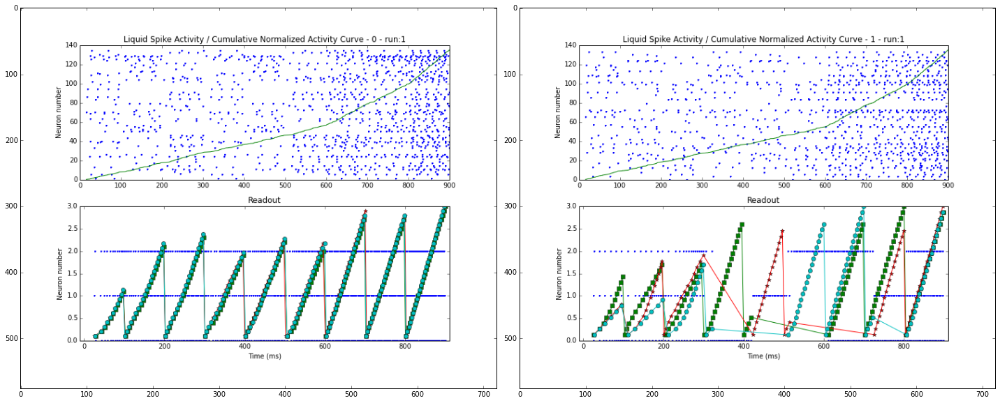

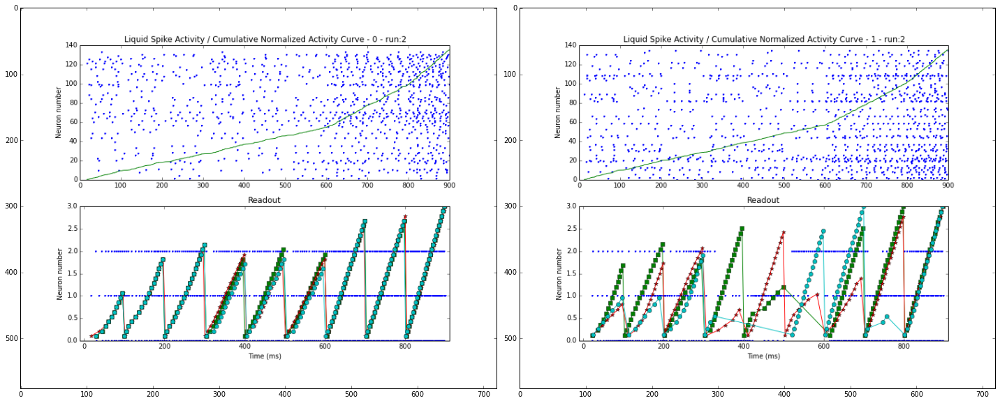

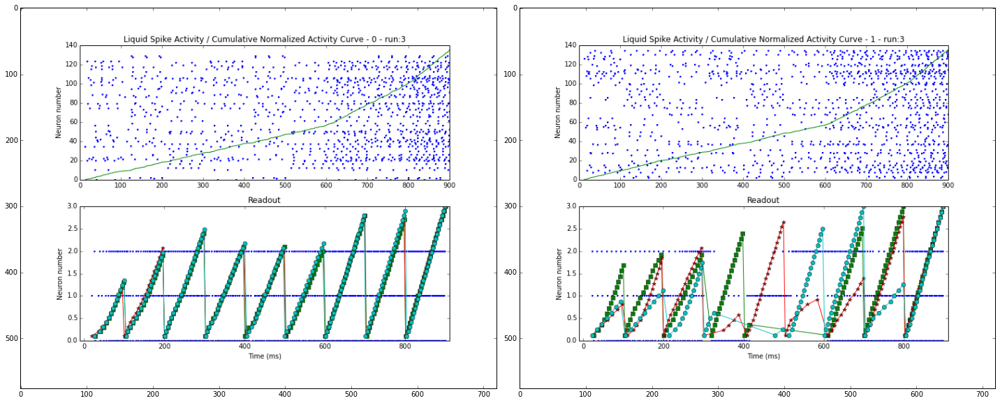

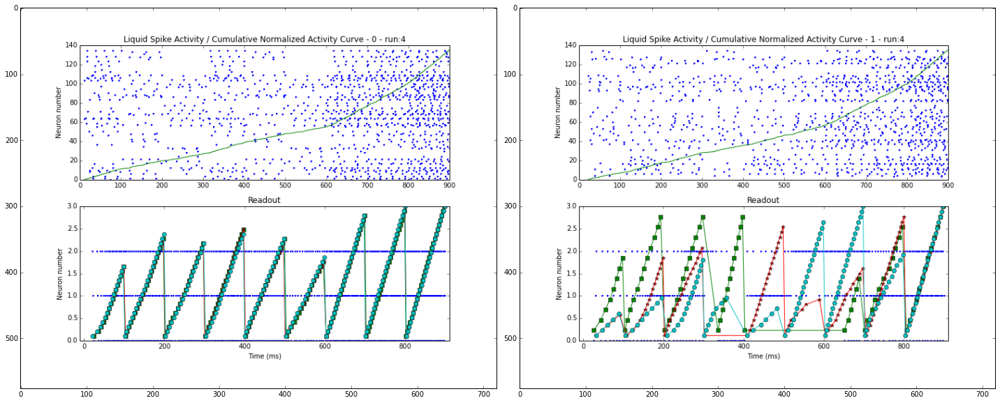

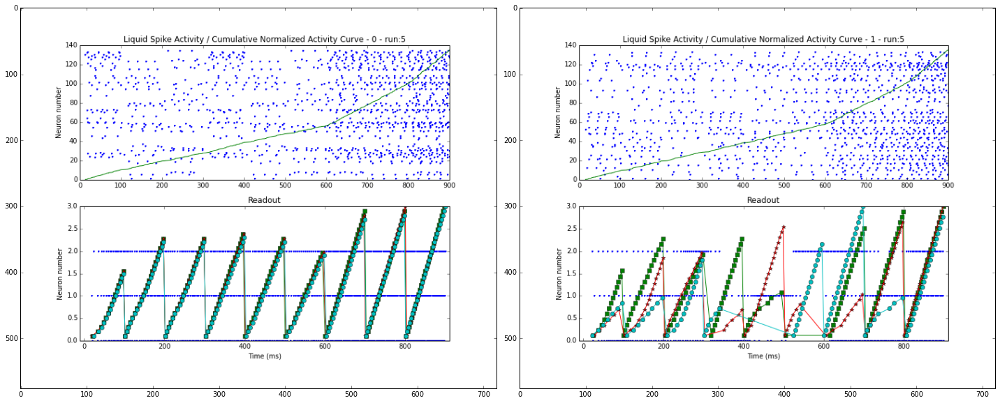

...

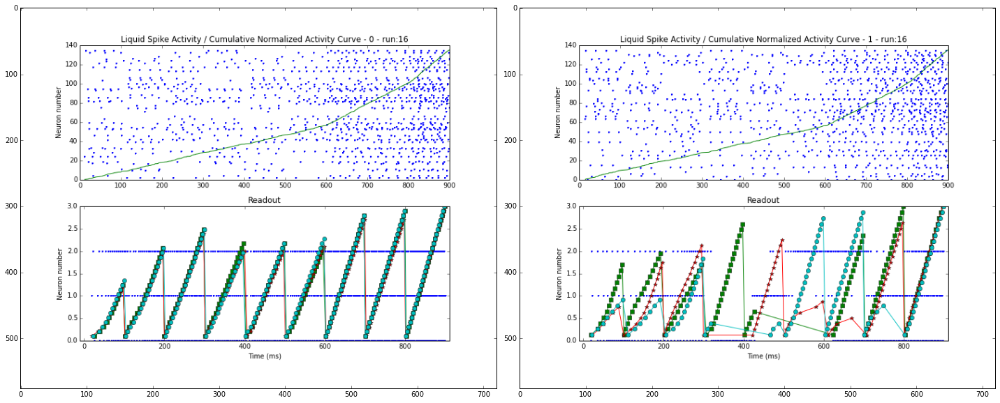

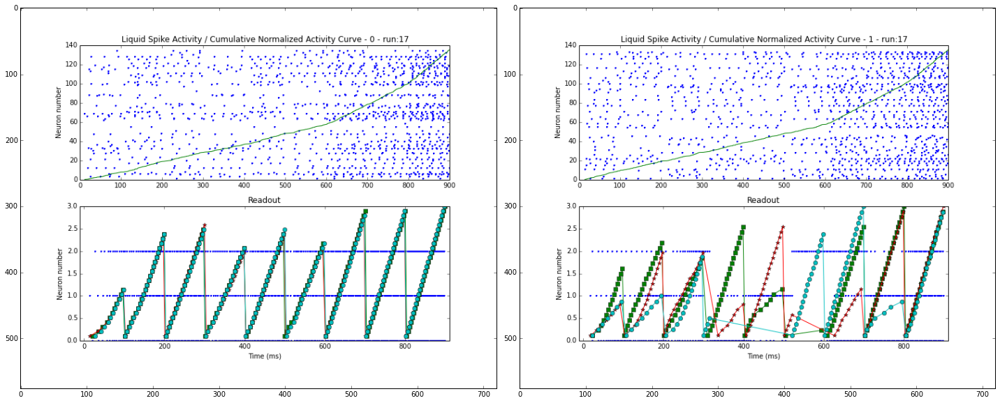

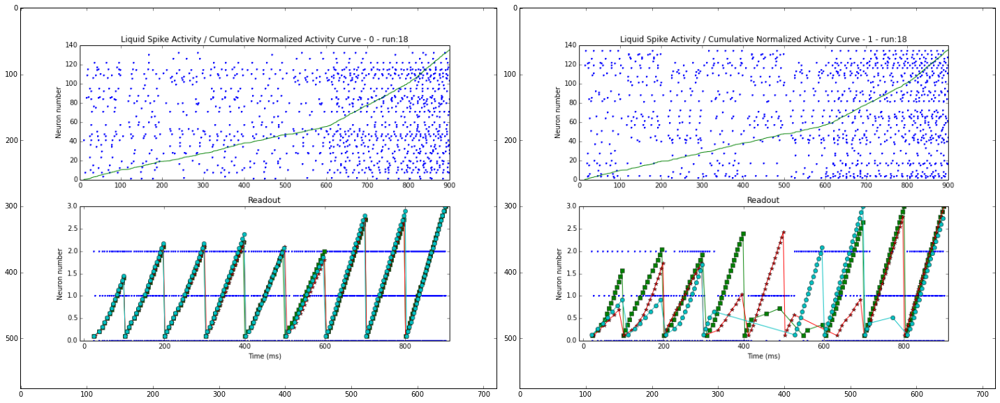

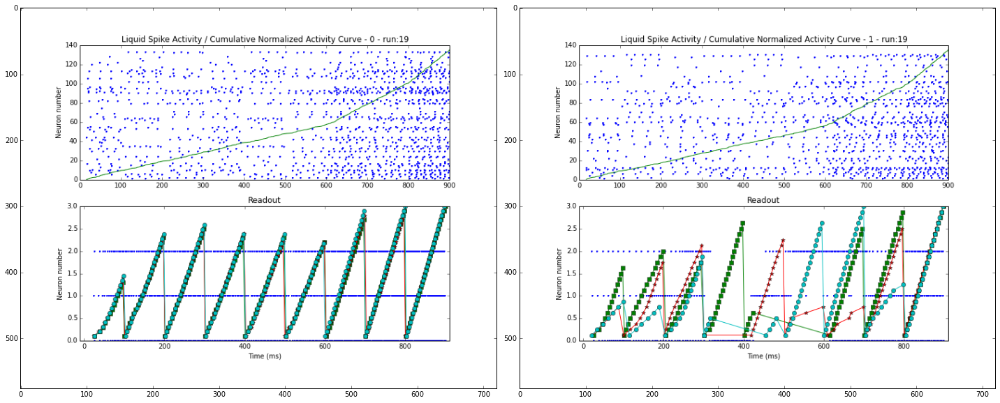

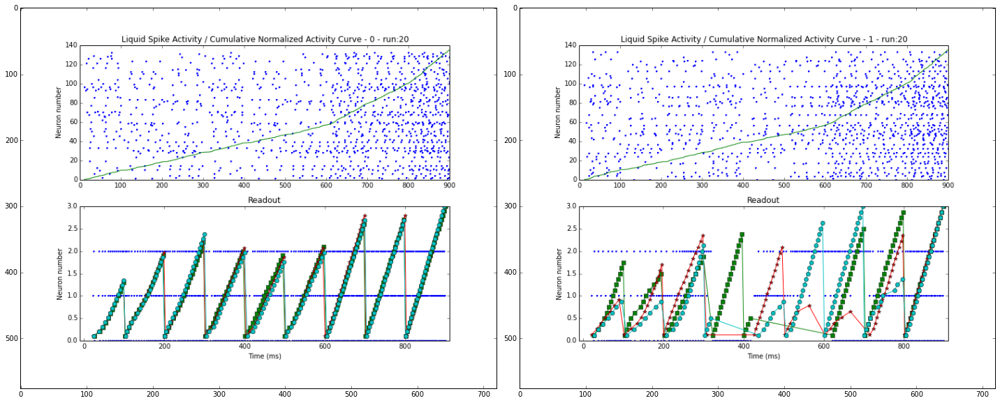

In [334]:
from scipy import misc


for i in range(20):
    fig = figure(figsize=(20,20))
    subplot(221)
    imshow(misc.imread('LiquidActivity_Learning_'+str(0)+"-"+str(i+1)+'.png'))
    subplot(222)
    imshow(misc.imread('LiquidActivity_Learning_'+str(1)+"-"+str(i+1)+'.png'))
    tight_layout()
show()

## Conclusions and Discussion  
Here was presented the Biased Unsupervised Learning Method, a novel (??) training algorithm for spiking neural networks. The main idea was to implement a very simple model of attention filtering [Broadbent, D (1958)] based in a switch that controlled when the STDP was able to unsupervised actuate changing the weights. The preliminary results showed that using such a simple technique the network was able to excel in comparison to the normal unsupervised use of the STDP.
Future experiments must be done to verify how to apply the method with more complex inputs where the time when the neurons spike is part of the information supplied to the network or the extension of the type of computations done by the system.

## ANNEXES

## 1.Liquid's structure and weights for each run
### The figures at the left side are the normal method and at the right side the new one.

### Liquid's structure

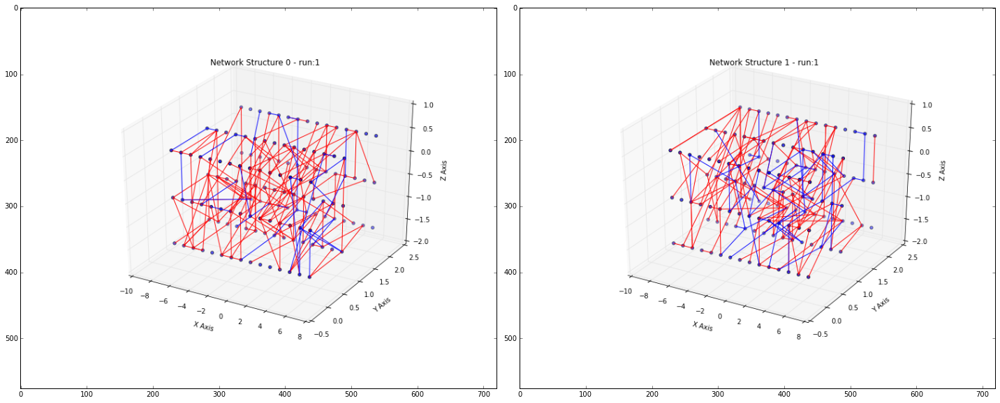

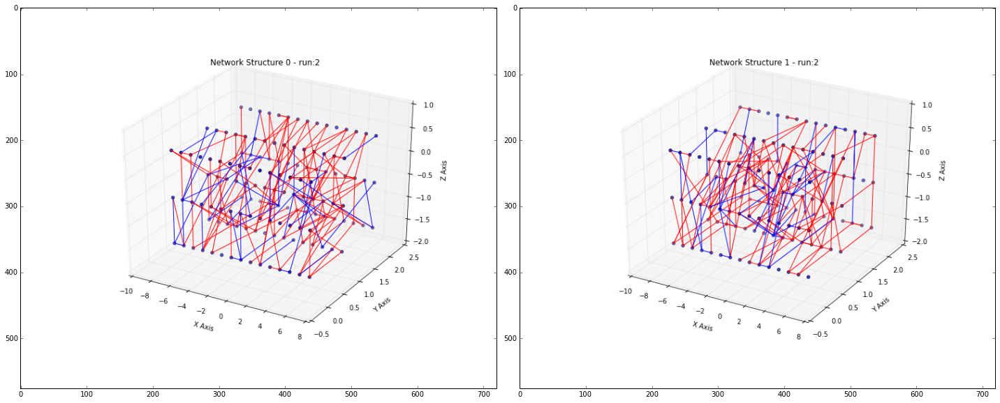

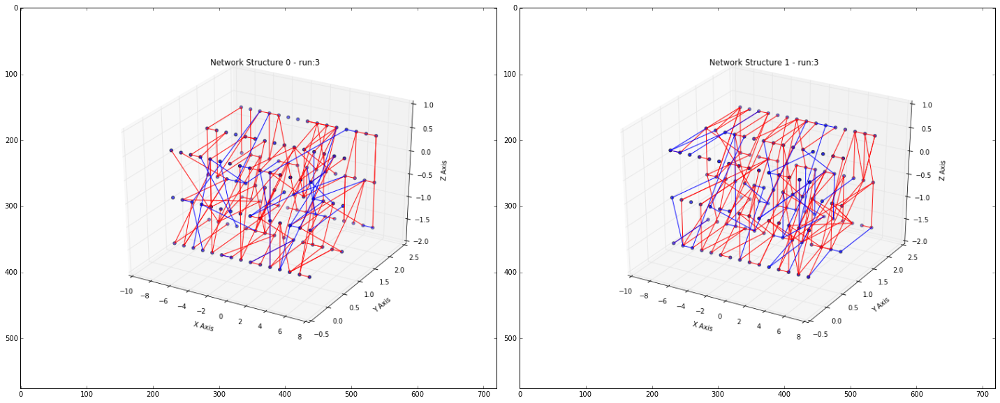

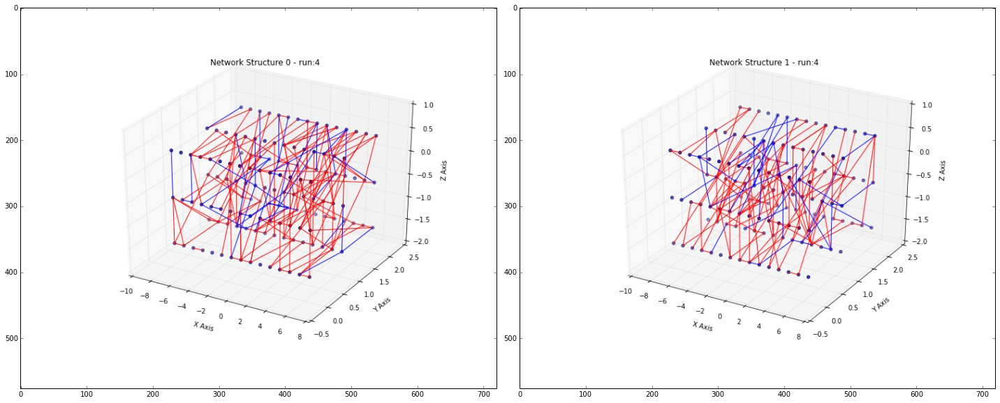

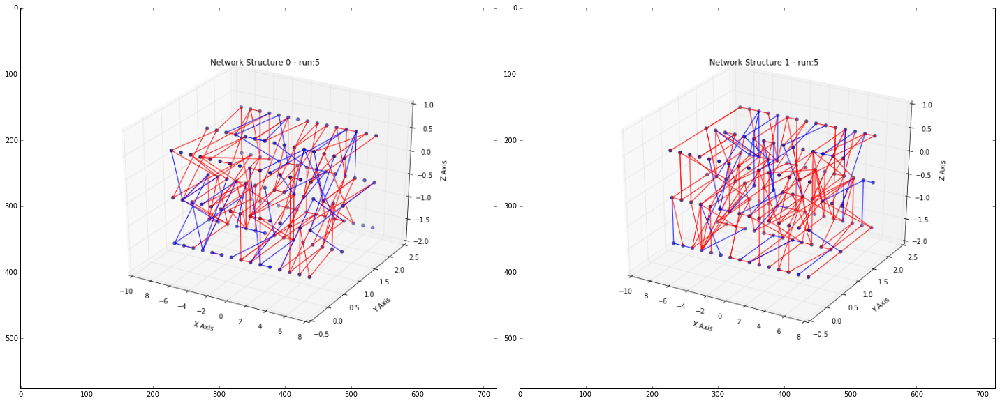

...

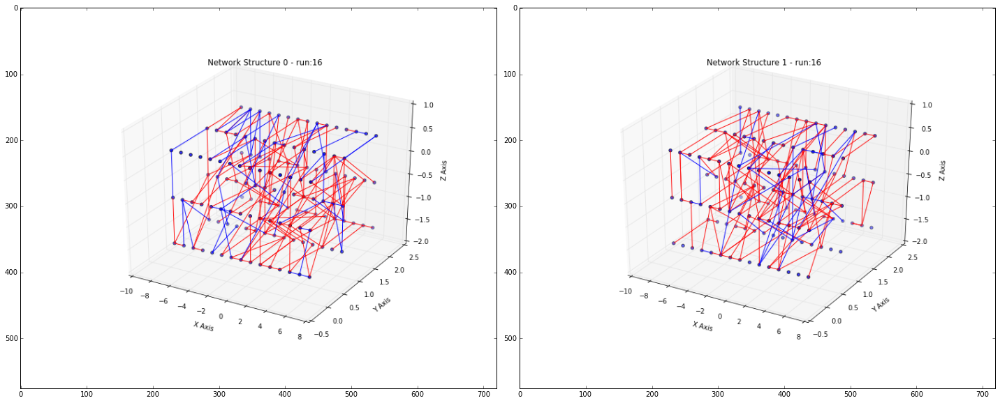

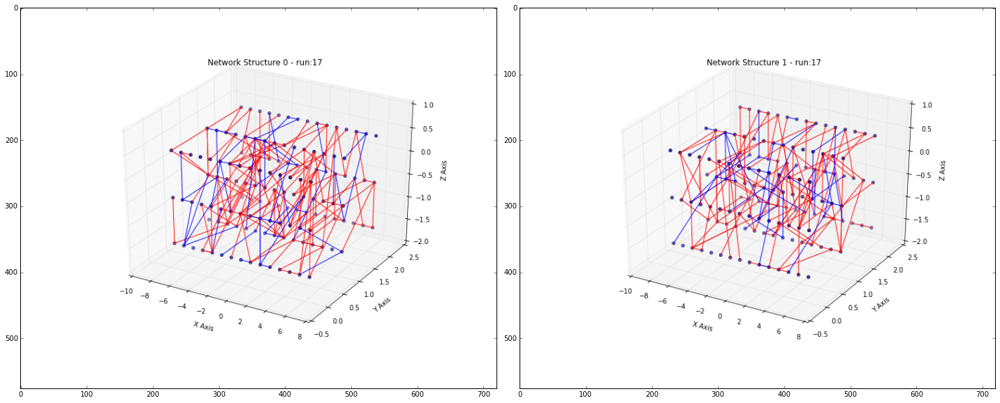

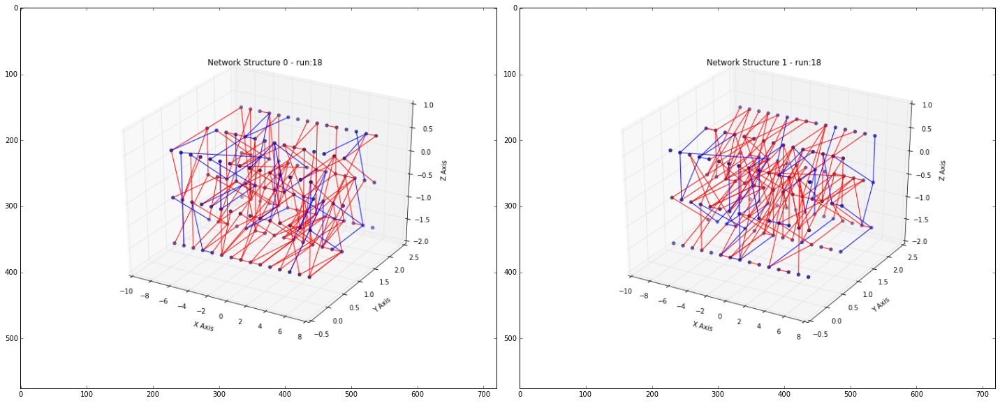

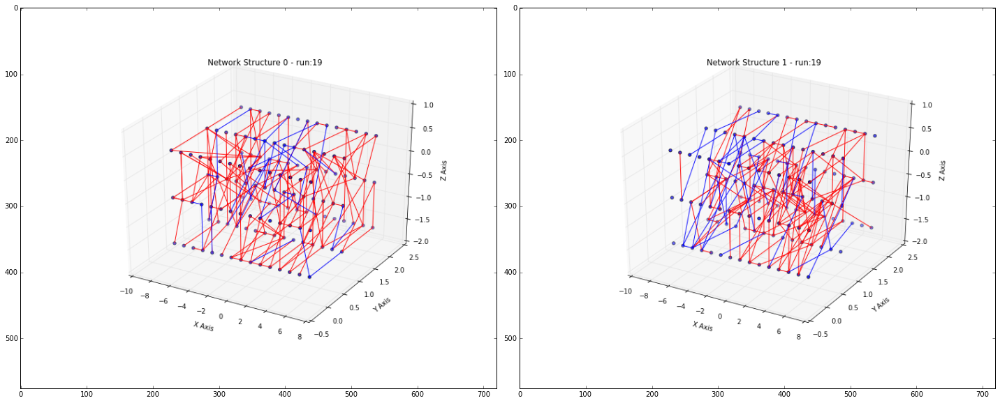

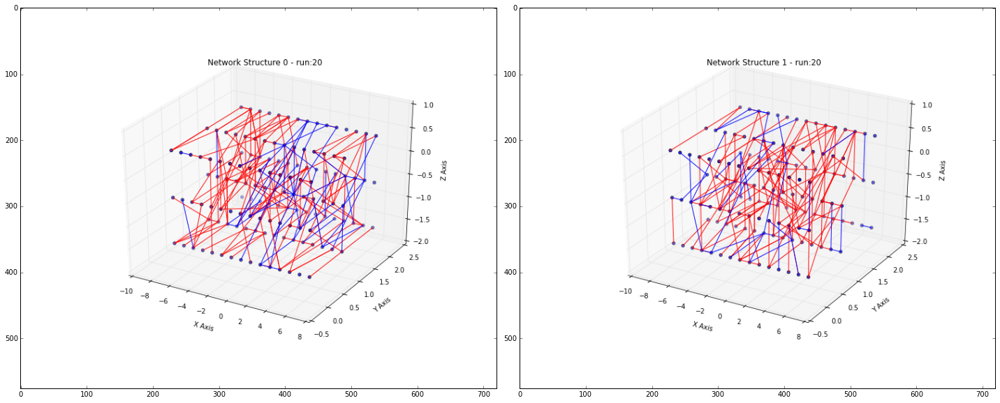

In [341]:
from scipy import misc


for i in range(20):
    fig = figure(figsize=(20,20))
    subplot(221)
    imshow(misc.imread('NetworkStructure_'+str(0)+"-"+str(i+1)+'.png'))
    subplot(222)
    imshow(misc.imread('NetworkStructure_'+str(1)+"-"+str(i+1)+'.png'))
    tight_layout()
show()

### Weights before and after learning

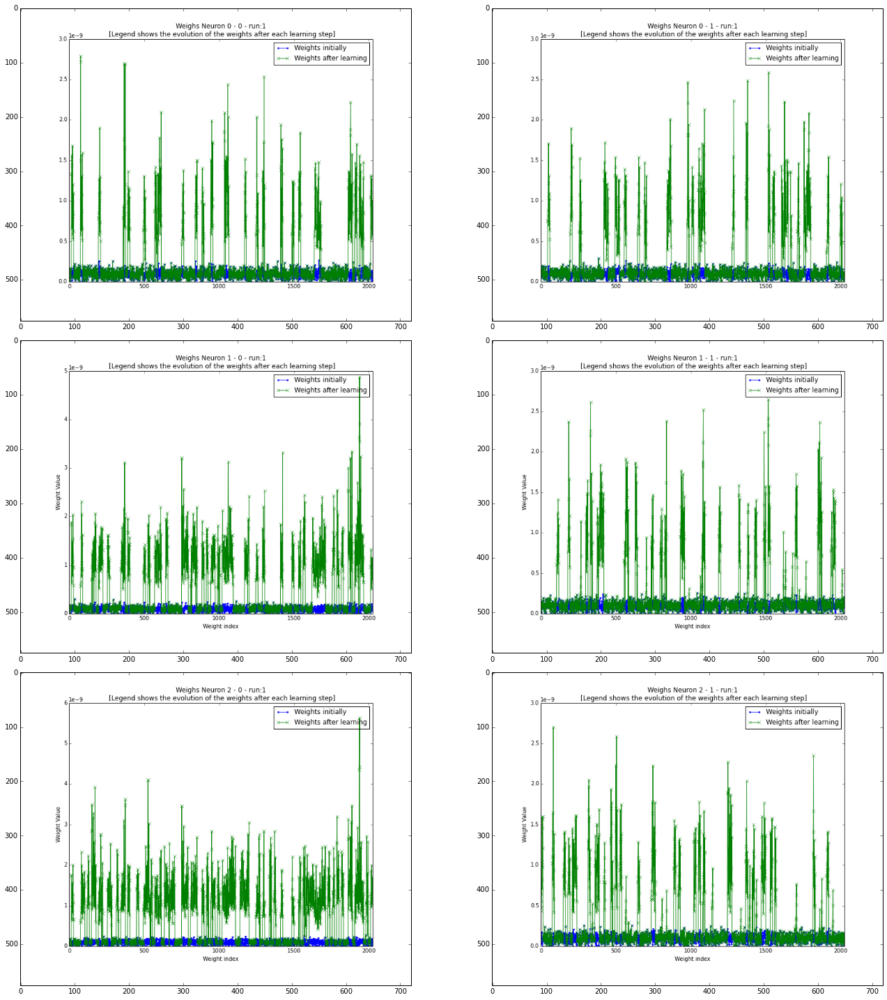

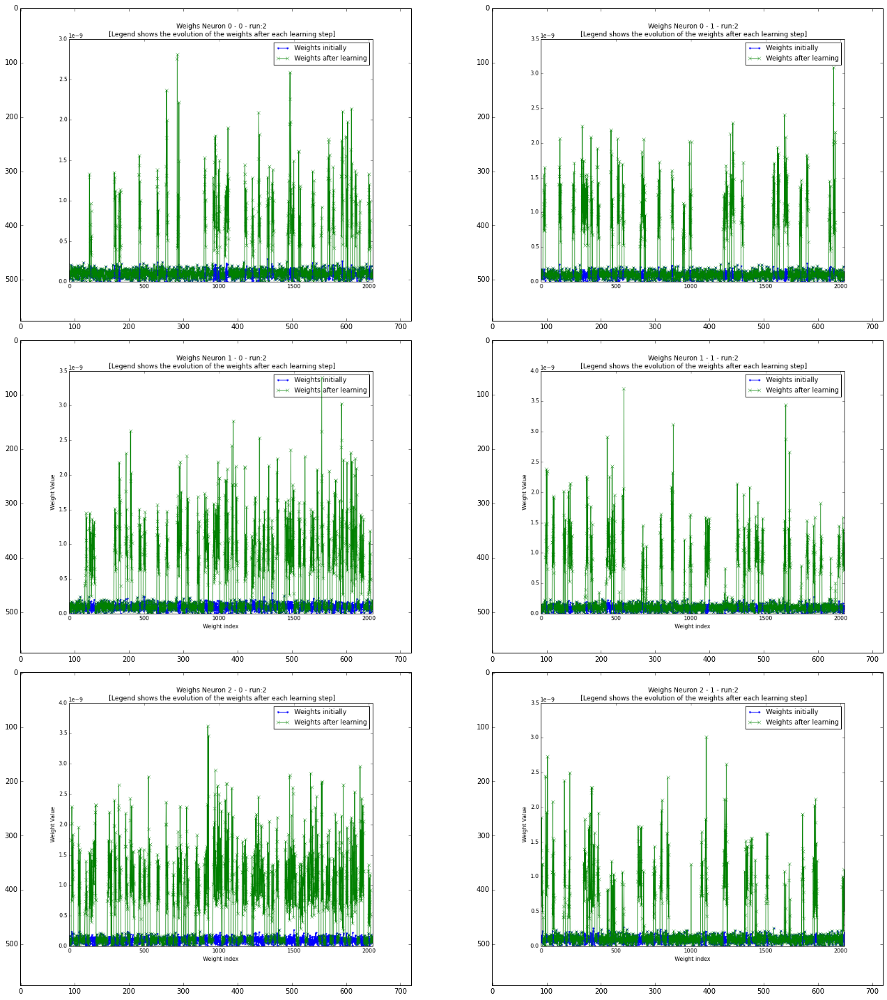

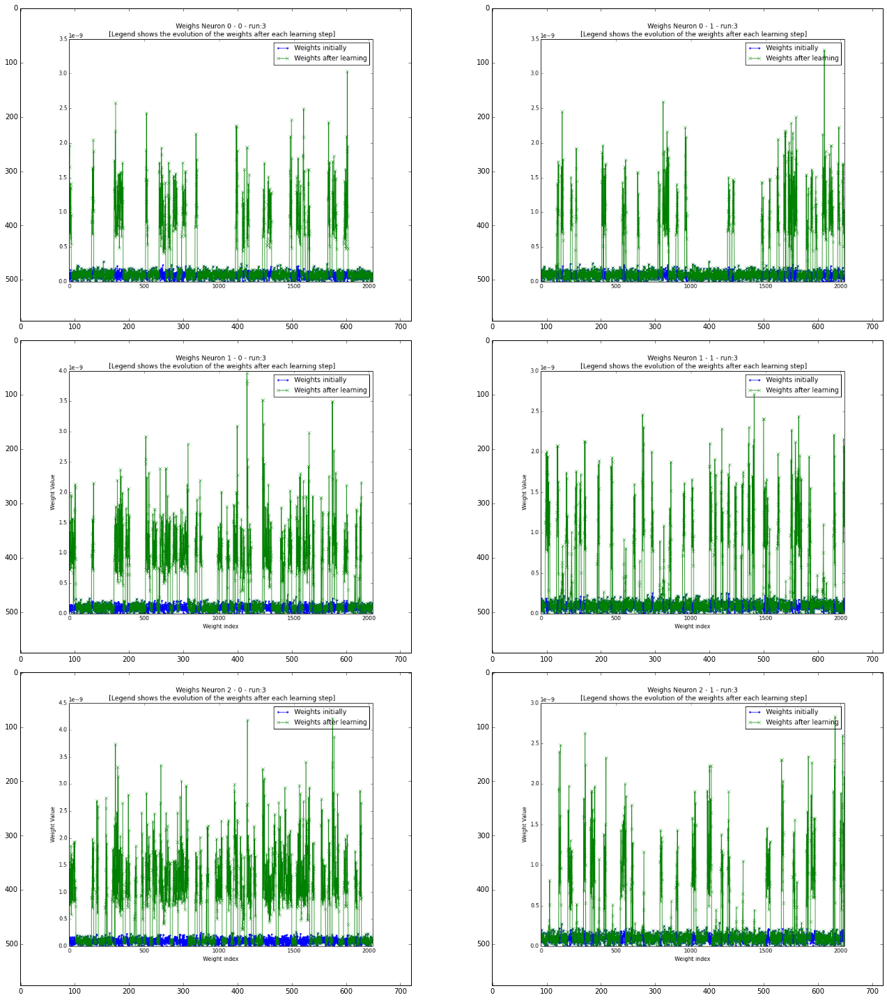

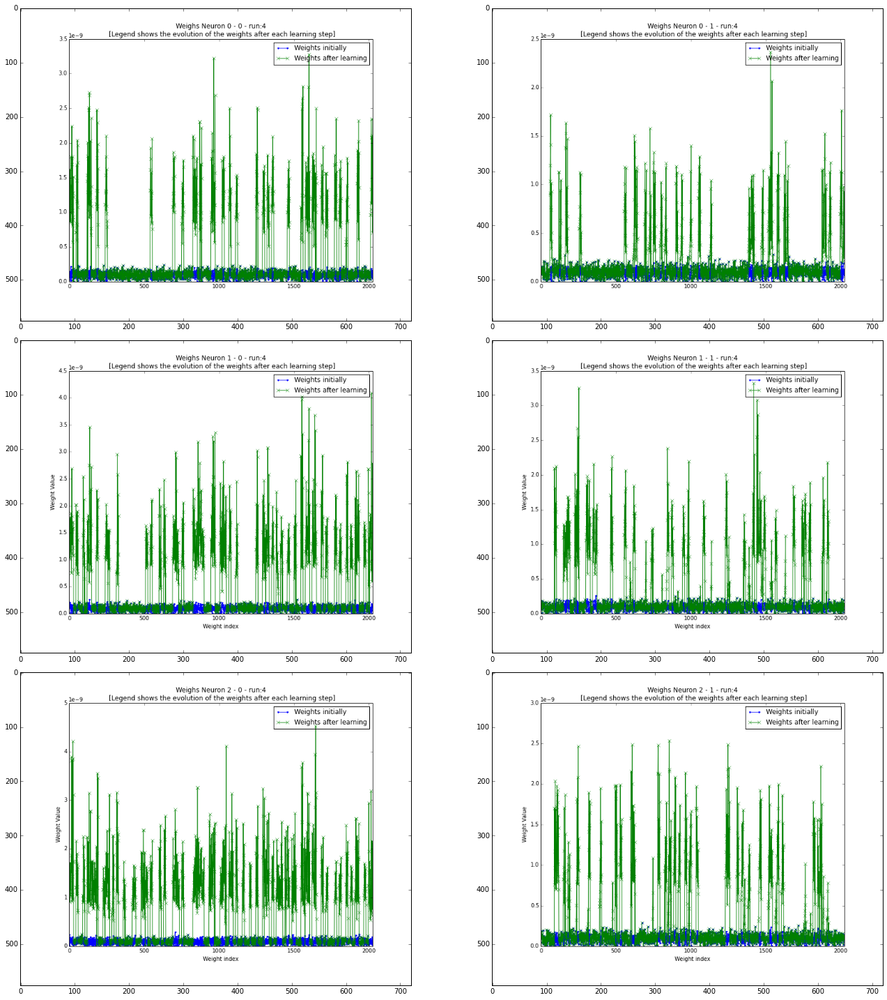

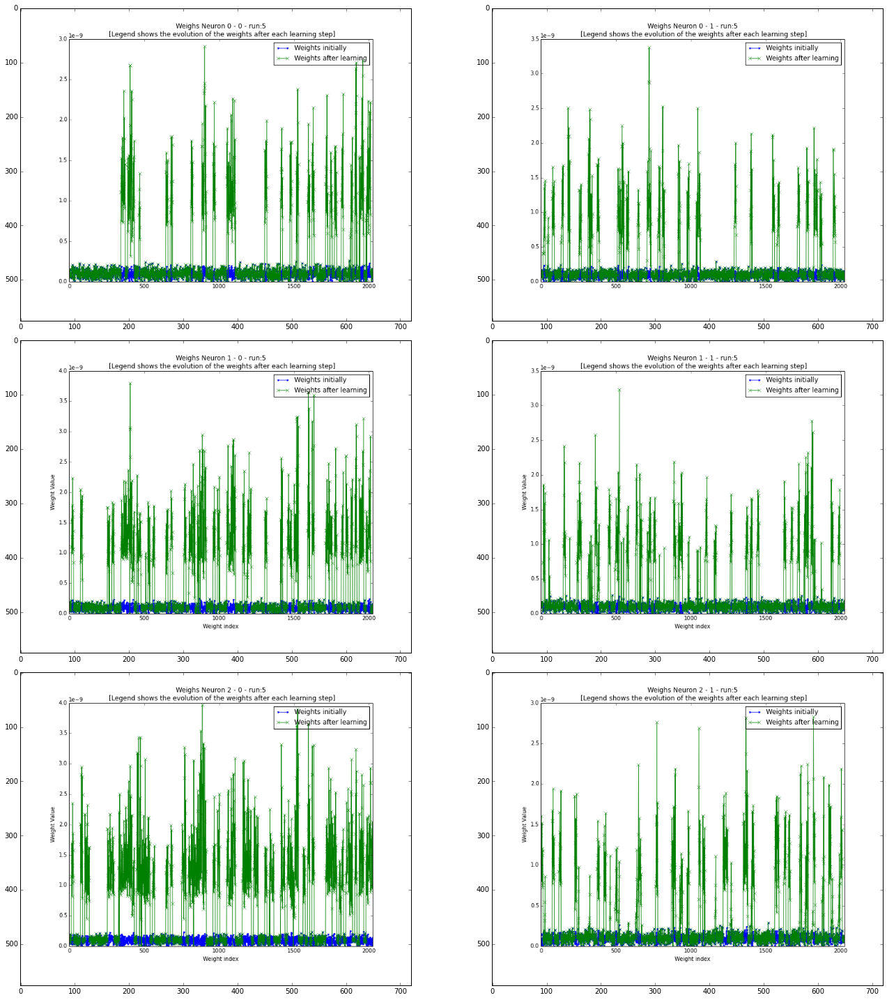

...

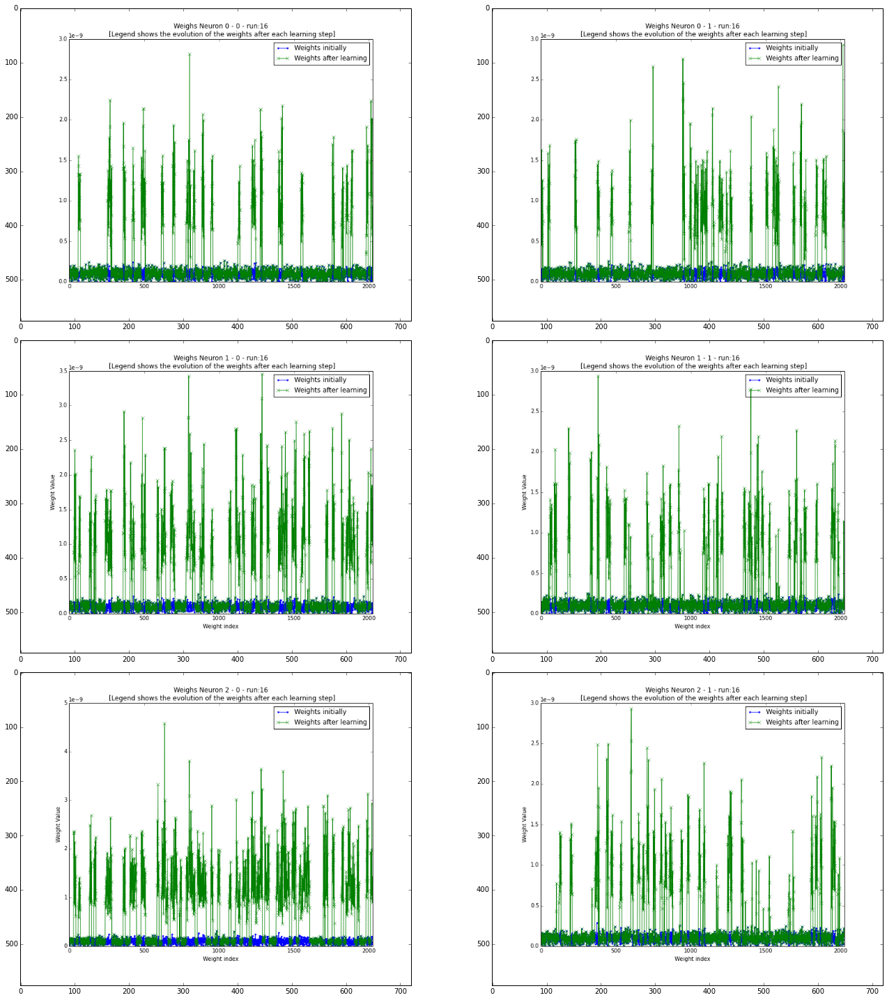

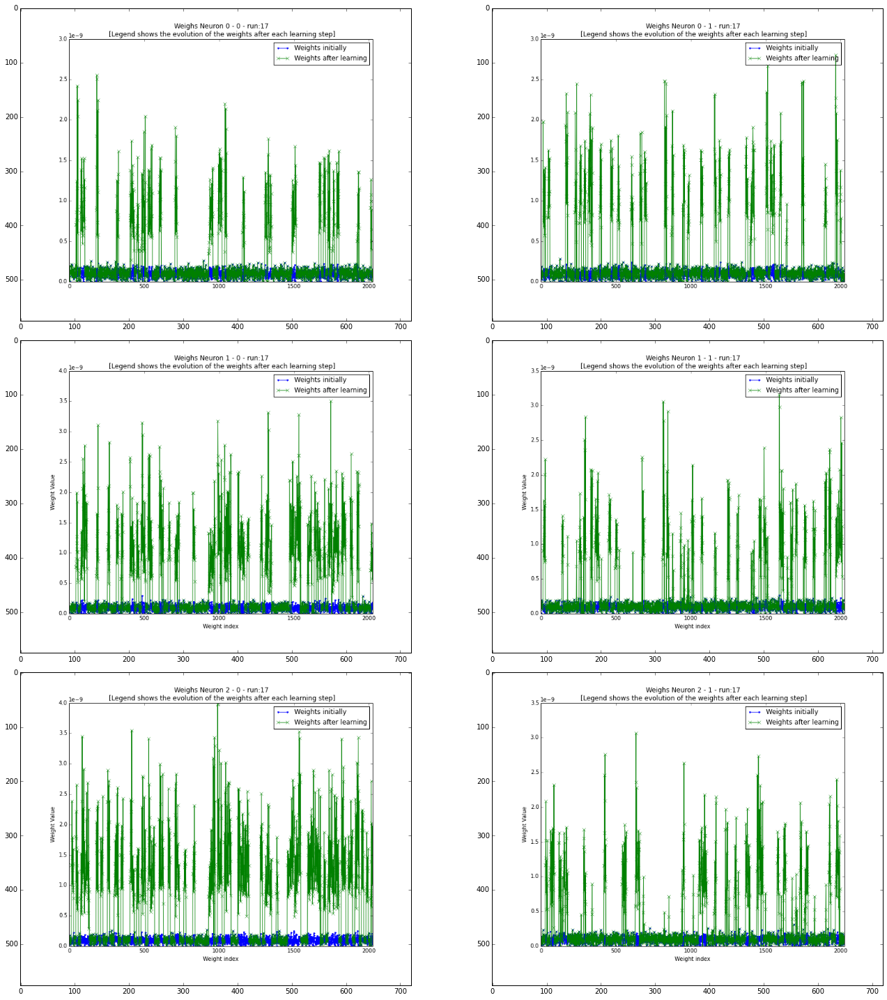

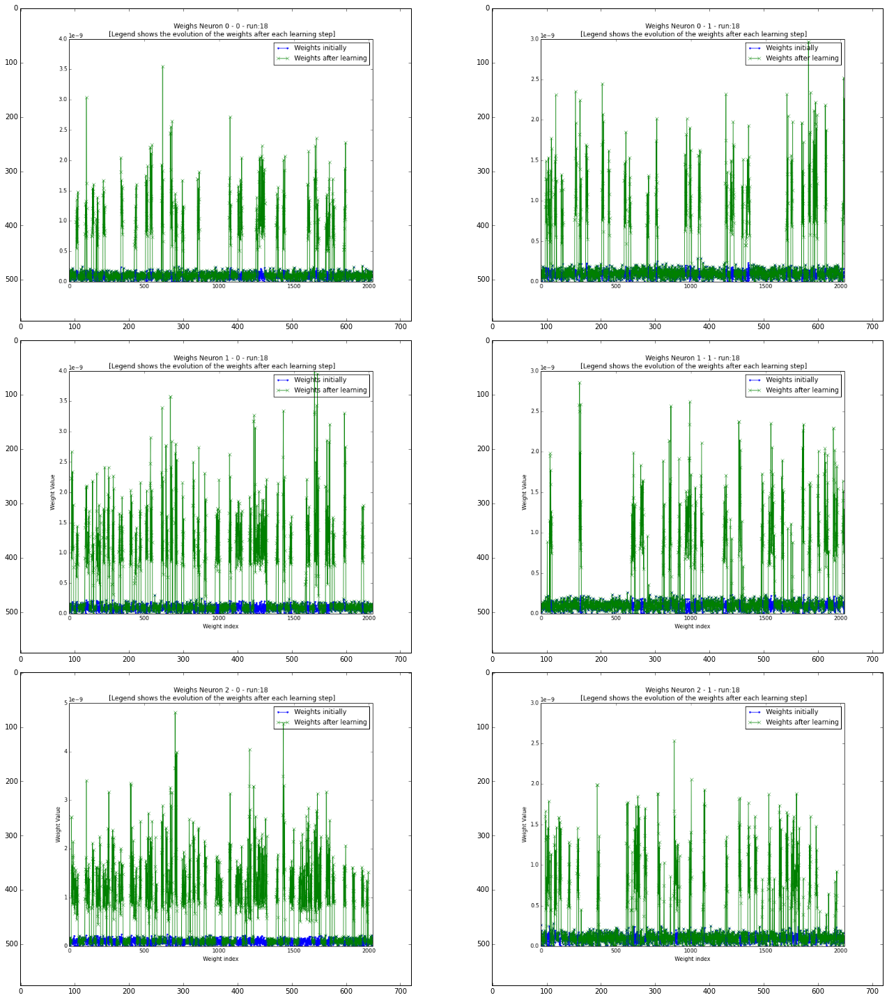

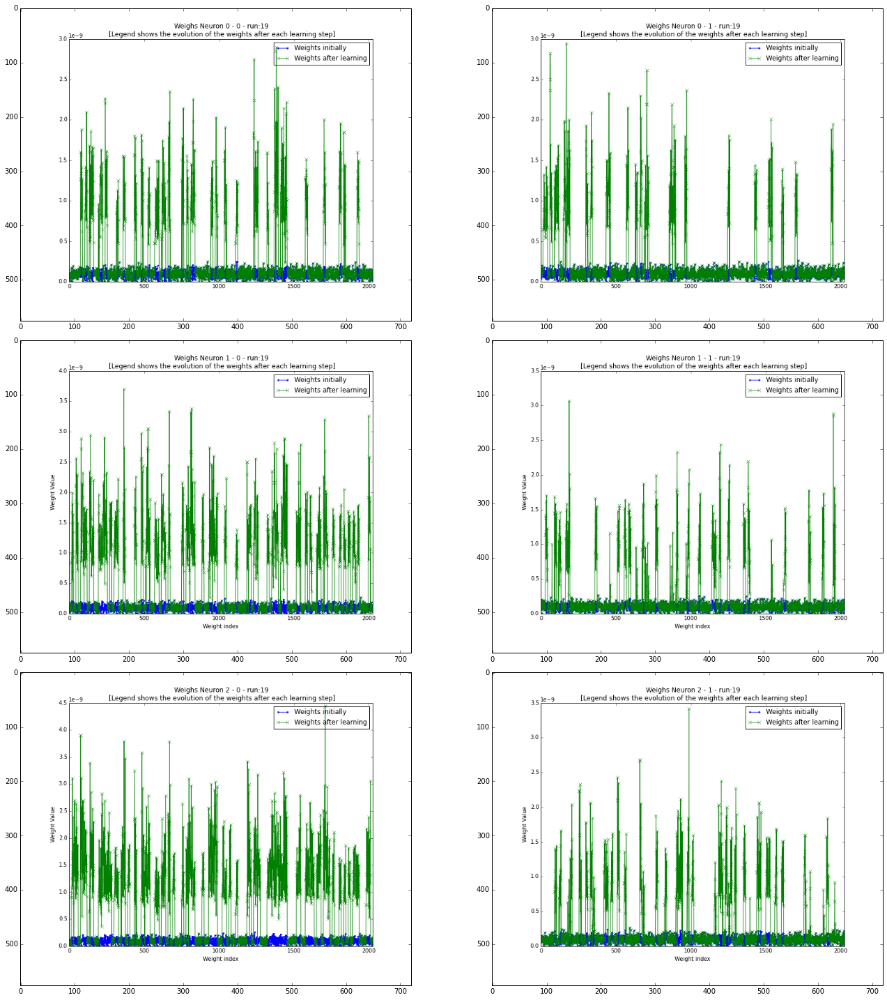

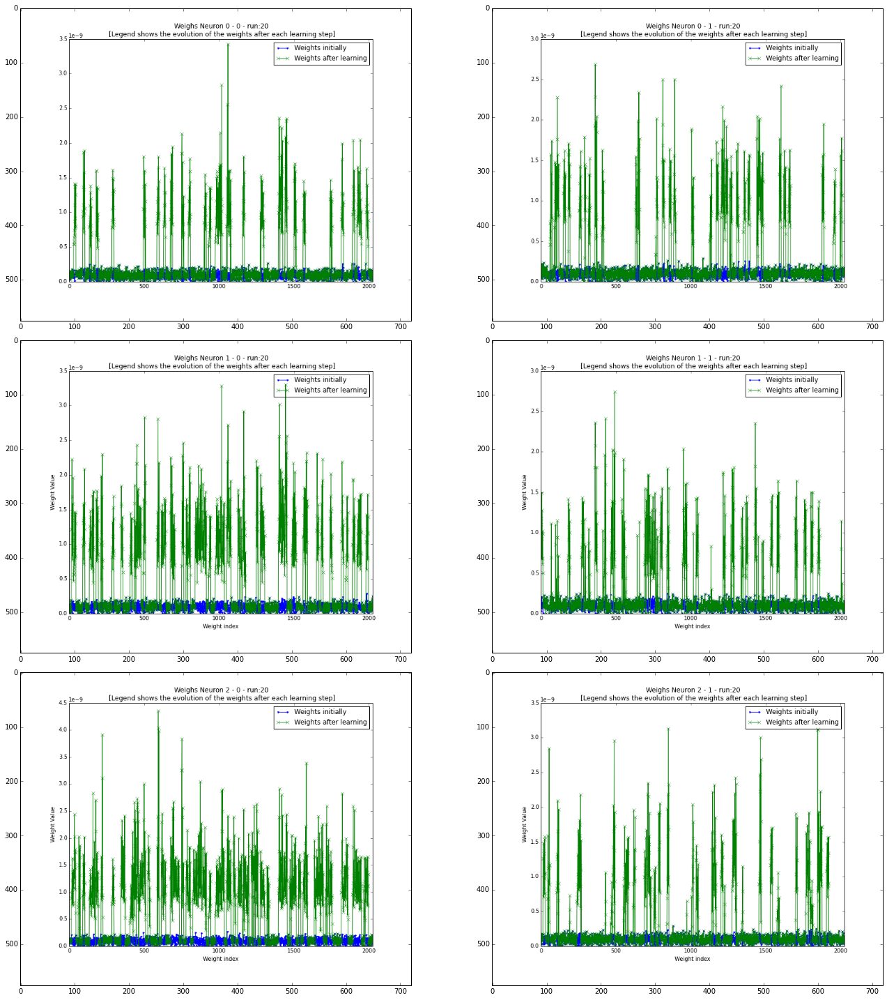

In [340]:
from scipy import misc


for i in range(20):
    fig = figure(figsize=(20,20))
    subplot(3,2,1)
    imshow(misc.imread('WeightsNeuron0_'+str(0)+"-"+str(i+1)+'.png'))
    subplot(3,2,2)
    imshow(misc.imread('WeightsNeuron0_'+str(1)+"-"+str(i+1)+'.png'))
    subplot(3,2,3)
    imshow(misc.imread('WeightsNeuron1_'+str(0)+"-"+str(i+1)+'.png'))
    subplot(3,2,4)
    imshow(misc.imread('WeightsNeuron1_'+str(1)+"-"+str(i+1)+'.png'))
    subplot(3,2,5)
    imshow(misc.imread('WeightsNeuron2_'+str(0)+"-"+str(i+1)+'.png'))    
    subplot(3,2,6)
    imshow(misc.imread('WeightsNeuron2_'+str(1)+"-"+str(i+1)+'.png'))        
    
    tight_layout()
show()

## 2.Python code to simulate the system using Brian

In [1]:
%matplotlib inline
# rcParams['figure.figsize'] = (10.0, 8.0)

In [145]:
run_number = 0
method_type = 1

In [3]:
#
# Biased Unsupervised Learning Method
#
def BiasedSTDP():

    global method_type,run_repetitions

    method_type = 1
    
    # Input0 is ON and readout0 is learning!
    syn_world_Input0.w=weights_input_liquid # turn ON Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)
    a = syn_lsm_out.w[:]
    Wlearn.append(a.tolist()) # weights 1 - neuron 0 learning!


    # Input1 is ON and readout1 is learning!
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn ON Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)
    a = syn_lsm_out.w[:]
    Wlearn.append(a.tolist()) # weights 2 - neuron 1 learning!


    # Input2 is ON and readout2 is learning!
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)
    a = syn_lsm_out.w[:]
    Wlearn.append(a.tolist()) # weights 3 - neuron 2 learning!


    syn_out_out.w=-10*nA # turn ON the inhibition between the output neurons

    # Input0 is ON!
    syn_world_Input0.w=weights_input_liquid # turn ON Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)



    # Input1 is ON!
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn ON Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)



    # Input2 is ON!
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)


    # Input0 and Input2 is ON!
    syn_world_Input0.w=weights_input_liquid # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)

    # Input0 and Input1 is ON!
    syn_world_Input0.w=weights_input_liquid # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)

    # Input0, Input1 and Input2 is ON!
    syn_world_Input0.w=weights_input_liquid # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)

    print "Simulation is finished!"

In [4]:
#
# Traditional Unsupervised STDP Method
#
def NormalSTDP():
    global method_type,run_repetitions
    
    method_type = 0
    
    run_repetitions=0
    
    # Input0 is ON
    syn_world_Input0.w=weights_input_liquid # turn ON Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=1 # turn OFF the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)
    a = syn_lsm_out.w[:]
    Wlearn.append(a.tolist()) # weights 1 - neuron 0 learning!


    # Input1 is ON
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn ON Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)
    a = syn_lsm_out.w[:]
    Wlearn.append(a.tolist()) # weights 2 - neuron 1 learning!


    # Input2 is ON
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=1 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)
    a = syn_lsm_out.w[:]
    Wlearn.append(a.tolist()) # weights 3 - neuron 2 learning!


    syn_out_out.w=-10*nA # turn ON the inhibition between the output neurons

    # Input0 is ON!
    syn_world_Input0.w=weights_input_liquid # turn ON Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)



    # Input1 is ON!
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn ON Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn OFF Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)



    # Input2 is ON!
    syn_world_Input0.w=0 # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)


    # Input0 and Input2 is ON!
    syn_world_Input0.w=weights_input_liquid # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=0 # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)

    # Input0 and Input1 is ON!
    syn_world_Input0.w=weights_input_liquid # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=0 # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)

    # Input0, Input1 and Input2 is ON!
    syn_world_Input0.w=weights_input_liquid # turn OFF Input0
    syn_lsm_out.LC[0:Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 0

    syn_world_Input1.w=weights_input_liquid # turn OFF Input1
    syn_lsm_out.LC[Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths]=0 # turn OFF the learning for the readout neuron 1

    syn_world_Input2.w=weights_input_liquid # turn ON Input2
    syn_lsm_out.LC[2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths]=0 # turn ON the learning for the readout neuron 2

    run_repetitions+=1
    net.run(sim_time*ms)

    print "Simulation is finished!"

### Start from this point to run several batches

In [279]:
run_number += 1

import brian_no_units # Speed up Brian by ignoring the units

from brian import *

import numpy

import sys # Used only to finish the program early during the debug 

import time # Used to calculate the time spent during the simulations


import lsm_connections_probability as lm # Creates the 3D Grid and the connections according to Maass 2002

import lsm_dynamical_synapses_v1 as ls # Creates the dynamical synapses according to Maass 2002 and using the output 
                                       # from the lsm_connections_probability

import plot_3d_connections as p3d # Plots the neurons and the connections (blue-> inhibitory and red->excitatory) in 3D

import plot_spikes as ps # Helper plots to watch changes in the raster plots


print "#"*78
print "#"*78
print "Liquid State Machine - Implementation of the Maass 2002 and Joshi 2004 papers!"
print "#"*78
print "#"*78


# This is useful when working with Ipython using %run
# if ('net' in vars()) and str(type(net))=="<class 'brian.network.Network'>":
#     print "Reseting the Brian Simulation objetc..."
#     net.reinit()

print "Reseting the Brian Simulation objetc...",
reinit()
print "Done!"

defaultclock.dt = .2*ms  # According to Maass2002 (0.2ms) - Brian default is 0.1ms

# LIQUID: Maass 2002
Number_of_neurons_lsm = 135
Net_shape= (15,3,3)


# This is for the Liquid
lsm_3dGrid_flat = numpy.zeros(Number_of_neurons_lsm) # This creates a numpy 1D array with 'Number_of_neurons_lsm' positions
                                                     # I'm using a numpy array to be able to use the reshape method to 
                                                     # change from 1D (vector) to 3D (matrix)
        

def randon_inhibitory_gen(Number_of_neurons, ratio_inh):
    '''
    Generate the random inhibitory neuron indexes list according to the number of neurons and the ratio
    '''
#     # List used to generate the randoms 'ratio_inh' inhibitory indexes for the Liquid
#     l_range = range(Number_of_neurons)

#     # Generates the random "indexes" of the flattened version of the 3DGrid corresponding to the inhibitory neurons
#     # At each iteration one random item is extracted from l_range and inserted in inhibitory_index.
#     # This is the way I've found to sample without repetitions.
#     inhibitory_index = [l_range.pop(numpy.random.randint(0,len(l_range))) for i in range(int(Number_of_neurons*ratio_inh))] 
#     inhibitory_index.sort() #This is only useful to make easier to human beings to read the list :)
    
    inhibitory_index=numpy.arange(Number_of_neurons,dtype=numpy.int)
    numpy.random.shuffle(inhibitory_index)
    
    return inhibitory_index[:int(Number_of_neurons*ratio_inh)]


#
# Number of Inhibitory and Excitatory neurons - LIQUID - 20% of the total neurons
inhibitory_index_L = randon_inhibitory_gen(Number_of_neurons_lsm, 0.2)

#
# Number of Inhibitory and Excitatory neurons - INPUT - 20% of the total neurons
# inhibitory_index_I = randon_inhibitory_gen(Number_of_neurons_I, 0.2)
inhibitory_index_I = [] # DEBUG!!!!

# This is the dictionary that has all the connections parameters according to Maass 2002.
# It is necessary to create the 3D connections and the STP configuration matrixes
# E=>1 (excitatory) and I=>0 (inhibitory)
# Ex.: (0,0) => II
# Dynamical Synapses Parameters (STP):
Connections_Parameters={
                (0,0):[ # II
                    0.1,    # CGupta=0.1        # Parameter used at the connection probability - from Maass2002 paper
                    0.32,   # UMarkram=0.32     # Use (U) - Parameter used at the Dynamic Synapse - from Maass2002 paper
                    0.144,  # DMarkram=0.144    # Time constant for Depression (tau_rec) - used at the Dynamic Synapse - from Maass2002 paper					
                    0.06,   # FMarkram=0.06     # Time constant for Facilitation (tau_facil) - used at the Dynamic Synapse - from Maass2002 paper
                    2.8,    # AMaass=2.8        # (nA) In the Maass2002 paper the value is negative, but because I need a positive scale (random.normal parameter) and there is a negative sign in front of the abs function I changed this to positive
                    0.8     # Delay_trans = 0.8 # In Maass paper the transmission delay is 0.8 to II, IE and EI		
                      ],
                (0,1):[ # IE
                    0.4,    # CGupta=0.4
                    0.25,   # UMarkram=0.25
                    0.7,    # DMarkram=0.7
                    0.02,   # FMarkram=0.02
                    3.0,    # AMaass=3.0 #in the Maass2002 paper the value is negative, but because I need a positive scale (random.normal parameter) and there is a negative sign in front of the abs function I changed this to positive
                    0.8     # Delay_trans = 0.8 # in Maass paper the transmission delay is 0.8 to II, IE and EI
                      ],
                (1,0):[ # EI
                    0.2,    # CGupta=0.2
                    0.05,   # UMarkram=0.05
                    0.125,  # DMarkram=0.125
                    1.2,    # FMarkram=1.2
                    1.6,    # AMaass=1.6
                    0.8     # Delay_trans = 0.8 # in Maass paper the transmission delay is 0.8 to II, IE and EI
                      ],
                (1,1):[ # EE
                    0.3,    # CGupta=0.3 
                    0.5,    # UMarkram=0.5
                    1.1,    # DMarkram=1.1
                    0.05,   # FMarkram=0.05
                    1.2,    # AMaass=1.2 #scaling parameter or absolute synaptic efficacy or weight - from Maass2002 paper
                    1.5     # Delay_trans = 1.5 # in Maass paper the transmission delay is 1.5 to EE connection
                      ]
}


# Utilizes the functions in the lsm_connections_probability.py
# =>output = {'exc':connections_list_exc,'inh':connections_list_inh, '3Dplot_a':positions_list_a, '3Dplot_b':positions_list_b}
# connections_list_exc= OR connections_list_inh=
    # ((i,j), # PRE and POS synaptic neuron indexes
    # pconnection, # probability of the connection
    # (W_n, U_ds, D_ds, F_ds), # parameters according to Maass2002
    # Delay_trans, # parameters according to Maass2002
    # connection_type)

# Generate the connections matrix inside the Liquid (Liquid->Liquid) - according to Maass2002
print "Generating the Liquid->Liquid connections...",
output_L_L = lm.generate_connections(lsm_3dGrid_flat, inhibitory_index_L, Net_shape, 
                                        CParameters=Connections_Parameters, lbd=1.2) # lbd controls the connections
print "Done!"

# Generate the connections matrix between the Input and the Liquid (Input->Liquid) - according to Maass2002
# print "Generating the Input->Liquid connections...",
# output_I_L = lm.generate_connections(input_3dGrid_flat, inhibitory_index_I, Net_shape_I, 
#                                      lsm_3dGrid_flat, inhibitory_index_L, Net_shape, 
#                                         CParameters=Connections_Parameters, lbd=3.3) # lbd controls the connections
# print "Done!"



#
# These are the cell's (neuron) parameters according to Maass 2002
#
cell_params_lsm = {  'cm'        : 30*nF,    # Capacitance of the membrane 
                                             # =>>>> MAASS PAPER DOESN'T MENTION THIS PARAMETER DIRECTLY
                                             #       but the paper mention a INPUT RESISTANCE OF 1MEGA Ohms and tau_m=RC=30ms, so cm=30nF
                     'i_offset'  : 0.0*nA,   # Offset current - random for each neuron from [14.975nA to 15.025nA] => Masss2002 - see code below
                     'tau_m'     : 30.0*ms,  # Membrane time constant => Maass2002
                     'tau_refrac_E': 3.0*ms, # Duration of refractory period - 3mS for EXCITATORY => Maass2002
                     'tau_refrac_I': 2.0*ms, # Duration of refractory period - 2mS for INHIBITORY => Maass2002
                     'tau_syn_E' : 3.0*ms,   # Decay time of excitatory synaptic current => Maass2002
                     'tau_syn_I' : 6.0*ms,   # Decay time of inhibitory synaptic current => Maass 2002
                     'v_reset'   : 13.5*mV,  # Reset potential after a spike => Maass 2002
                     'v_rest'    : 0.0*mV,   # Resting membrane potential => Maass 2002
                     'v_thresh'  : 15.0*mV,  # Spike threshold => Maass 2002
                     'i_inj'     : 0.0*nA    # Not used in Maass 2002
                  }


# Leaky integrate and fire model with fixed threshold and
# decaying-exponential post-synaptic current. (Separate synaptic currents for
# excitatory and inhibitory synapses.
# from Brian/PyNN documentation...
lsm_neuron_eqs='''
    dv/dt  = (ie + ii + i_offset + i_inj)/c_m + (v_rest-v)/tau_m : mV
    die/dt = -ie/tau_syn_E                : nA
    dii/dt = -ii/tau_syn_I                : nA
    tau_syn_E                             : ms
    tau_syn_I                             : ms
    tau_m                                 : ms
    c_m                                   : nF
    v_rest                                : mV
    i_offset                              : nA
    i_inj                                 : nA
    '''


########################################################################################################################
#
# LIQUID - Setup
#
print "LIQUID - Setup...",

# Creates a vector with the corresponding refractory period according to the type of neuron (inhibitory or excitatory)
# IT MUST BE A NUMPY ARRAY!!!!!
refractory_vector = [ cell_params_lsm['tau_refrac_E'] ]*Number_of_neurons_lsm # fills the list with the value corresponding to excitatory neurons
for i in range(Number_of_neurons_lsm):
    if i in inhibitory_index_L:
        refractory_vector[i]=cell_params_lsm['tau_refrac_I'] # only if the neuron is inibitory, changes the refractory period value!
refractory_vector=numpy.array(refractory_vector) # Here it is converted to a NUMPY ARRAY


# This is the population (neurons) used exclusively to the Liquid (pop_lsm).
pop_lsm = NeuronGroup(Number_of_neurons_lsm, model=lsm_neuron_eqs, 
                                             threshold=cell_params_lsm['v_thresh'], 
                                             reset=cell_params_lsm['v_reset'], 
                                             refractory=refractory_vector, 
                                             max_refractory=max(cell_params_lsm['tau_refrac_E'], 
                                                                cell_params_lsm['tau_refrac_I']))

# Here I'm mixing numpy.fill with the access of the state variable "c_m" in Brian (because Brian is using a numpy.array)
# Sets the value of the capacitance according to the cell_params_lsm (same value to all the neurons)
pop_lsm.c_m.fill(cell_params_lsm['cm'])


# Sets the value of the time constant RC (or membrane constant) according to the cell_params_lsm (same value to all the neurons)
pop_lsm.tau_m.fill(cell_params_lsm['tau_m'])

# sets the i_offset according to Maass2002
# this current should be drawn from a uniform distr [14.975,15.025]
pop_lsm.i_offset=numpy.random.uniform(14.975,15.025, Number_of_neurons_lsm)*nA

pop_lsm.i_offset=pop_lsm.i_offset/1.08 # my tweaking to avoid spikes when no input is presented

                                      # THIS VALUE SEEMS TO BE VERY IMPORTANT. IF I INCREASE OR DECREASE THE SYSTEM CANNOT
                                      # LEARN TO RECOGNISE MY INPUTS ANYMORE!!!!!!!!

pop_lsm.tau_syn_E.fill(cell_params_lsm['tau_syn_E']) # (same value to all the neurons)
pop_lsm.tau_syn_I.fill(cell_params_lsm['tau_syn_I']) # (same value to all the neurons)

pop_lsm.v_rest.fill(cell_params_lsm['v_rest']) # (same value to all the neurons)

pop_lsm.i_inj.fill(cell_params_lsm['i_inj']) # (same value to all the neurons)


# sets the initial membrane voltage according to Maass2002
# this current should be drawn from a uniform distr [13.5mV,15.0mV]
pop_lsm.v=numpy.random.uniform(13.5,15.0, Number_of_neurons_lsm)*mV

# DEBUG
pop_lsm.v=numpy.random.uniform(13.73-0.75,13.73+0.75, Number_of_neurons_lsm)*mV
# with these initial values the initial v becames more similar to the values when there is no input


# Creates the object to generate the synapses Liquid->Liquid (EXCITATORY AND INHIBITORY)
syn_lsm_obj = ls.LsmConnections(pop_lsm, pop_lsm, output_L_L)

# Generates the Liquid->Liquid - EXCITATORY synapses
syn_lsm_exc = syn_lsm_obj.create_synapses('exc')

# Generates the Liquid->Liquid - INHIBITORY synapses
syn_lsm_inh = syn_lsm_obj.create_synapses('inh')

print "Done!"

print "Number of excitatory synapses in the Liquid: " + str(len(syn_lsm_exc)) # DEBUG to verify if it is working
print "Number of inhibitory synapses in the Liquid: " + str(len(syn_lsm_inh)) # DEBUG to verify if it is working

#
# End of the LIQUID - Setup
########################################################################################################################



########################################################################################################################
#
# INPUT - Setup
#
print "INPUT - Setup...",

Number_of_neurons_inputs = 3

spiketimes0 = [(0,1*ms)] # 0 0 1
Input0 = SpikeGeneratorGroup(Number_of_neurons_inputs, spiketimes0, period=2*ms)

spiketimes1 = [(1,1*ms)] # 0 1 0
Input1 = SpikeGeneratorGroup(Number_of_neurons_inputs, spiketimes1, period=2*ms)

spiketimes2 = [(2,1*ms)] # 1 0 0
Input2 = SpikeGeneratorGroup(Number_of_neurons_inputs, spiketimes2, period=2*ms)

# Here the synapses are created. The synapses created are ALWAYS excitatory because it is 
# connecting through 'ie' in the neuron model!
#
#
syn_world_Input0=Synapses(Input0, pop_lsm,
                                               model='''w : 1''',
                                               pre='''ie+=w''')

syn_world_Input1=Synapses(Input1, pop_lsm,
                                               model='''w : 1''',
                                               pre='''ie+=w''')

syn_world_Input2=Synapses(Input2, pop_lsm,
                                               model='''w : 1''',
                                               pre='''ie+=w''')


weights_input_liquid = [] # remember that the weights must follow the same order of the creation of synapses
AIL_M = 1 # mean value of the weights (without the multiplication by nA!)

for i in range(Number_of_neurons_inputs):
    rand_connections = randon_inhibitory_gen(Number_of_neurons_lsm, 1/3.0) # generates random connections to approx. 30% of the liquid
    for j in rand_connections:
        syn_world_Input0[i,j] = True # so it is one-to-random_30%
        syn_world_Input1[i,j] = True # so it is one-to-random_30%
        syn_world_Input2[i,j] = True # so it is one-to-random_30%
        # All inputs have the same connections
        weights_input_liquid.append(abs(numpy.random.normal(loc=AIL_M, scale=AIL_M/2.0))*nA)

weights_input_liquid = numpy.array(weights_input_liquid)

syn_world_Input0.w = weights_input_liquid
syn_world_Input1.w = weights_input_liquid
syn_world_Input2.w = weights_input_liquid
# All inputs have the same weights

syn_world_Input0.delay=0*ms
syn_world_Input1.delay=0*ms
syn_world_Input2.delay=0*ms



print "Done!"

#
# End of the INPUT - Setup (creation of the connections between the Poisson input and the Liquid!)
#
########################################################################################################################



########################################################################################################################
#
# READOUT - Setup
#
print "READOUT - Setup...",

# Creates the neurons and connections (Synapse object) from the liquid to the READOUT (OUTPUT)
Number_of_neurons_readout = 3
pop_readout = NeuronGroup(Number_of_neurons_readout, model=lsm_neuron_eqs, 
                                                     threshold=cell_params_lsm['v_thresh'], 
                                                     reset=cell_params_lsm['v_reset'], 
                                                     refractory=3*ms)

# Sets the parameters of the neuron model (see the comments on the liquid setup above...)
pop_readout.c_m.fill(cell_params_lsm['cm'])
pop_readout.tau_m.fill(cell_params_lsm['tau_m'])
# pop_readout.i_offset=0.0*nA
pop_readout.i_offset = numpy.random.uniform(14.975,15.025, Number_of_neurons_readout)*nA
pop_readout.tau_syn_E = cell_params_lsm['tau_syn_E']
pop_readout.tau_syn_I = cell_params_lsm['tau_syn_I']
pop_readout.v_rest = cell_params_lsm['v_rest']
pop_readout.i_inj = cell_params_lsm['i_inj']
pop_readout.v = numpy.random.uniform(13.5,15.0, Number_of_neurons_readout)*mV

taupre = 5 * ms     # according to Oliveri 2007 is 2ms
taupost = taupre    # according to Oliveri 2007
gmax = 100*nA # no idea about the maximum weight here, so I'm choosing any value and testing :D
dApre = .01
dApost = -dApre*(taupre/taupost*1.05) # Here the negative sign (-) defines the shape of the Apost curve!
                                      # And because Apost+=dApost it is always negative!
dApost *= gmax
dApre *= gmax


# LC is the "learning control". What it does is to turn "ON" and "OFF" the modification of the weights.
# When LC=0:
# Apre=>doesn't change for that connection
# Apost=>doesn't change for that connection
# w=>doesn't change for that connection
syn_lsm_out = Synapses(pop_lsm, pop_readout,
             model='''w:1
             Apre:1
             Apost:1
             LC:1''',
             pre='''ie+=w
             Apre=Apre*exp((lastupdate-t)*LC/taupre)+dApre*LC
             Apost=Apost*exp((lastupdate-t)*LC/taupost)
             w=clip(w+Apost*LC,0,gmax)''',
             post='''
             Apre=Apre*exp((lastupdate-t)*LC/taupre)
             Apost=Apost*exp((lastupdate-t)*LC/taupost)+dApost*LC
             w=clip(w+Apre*LC,0,gmax)''')


# Generate the connections between the Liquid and the Readout
# The connections are all-to-one (each neuron in the Readout receives connections from all the neurons in the Liquid).
Number_of_paths=15
delay_counter=0
for j in xrange(Number_of_neurons_readout):
    for i in xrange(Number_of_neurons_lsm):
        for k in range(Number_of_paths):
            syn_lsm_out[i,j]=True # The "Number_of_neurons_lsm" connections are from readout neuron j
                                  #  This is useful to be able to change the LC only of some specific connections
            syn_lsm_out.delay[delay_counter]=.1*k**2*ms
            delay_counter+=1


readout_mean_W = 0.1 # in nA! I've NO idea about the best initial mean value for the weights!
syn_lsm_out.w=abs(numpy.random.normal(loc=readout_mean_W, scale=readout_mean_W/2.0, size=len(syn_lsm_out)))*nA # random weights (numpy array with the same size of the number of synapses)


syn_lsm_out.LC=0 # starts the simulation with the learning turned OFF!

print "Done!"

print "Number of connections between liquid and readout: " + str(len(syn_lsm_out))


# These connections are going to inhibity the others readout neurons when one is spiking
syn_out_out = Synapses(pop_readout, pop_readout,
             model='w:1',
             pre='ii+=w')

syn_out_out[0,1]=True
syn_out_out[0,2]=True

syn_out_out[1,0]=True
syn_out_out[1,2]=True

syn_out_out[2,0]=True
syn_out_out[2,1]=True


syn_out_out.w[:]=0

#
# End of the READOUT - Setup
#
#######################################################################################################################




#
# Select what to save (to plot at the end):

LSM = SpikeMonitor(pop_lsm)
ROUT = SpikeMonitor(pop_readout)


# RUN THE SIMULATION!!!
initial_time=time.time()

# Tuple with all the neuron groups used in this simulation
# populations_sim = pop_lsm, pop_input, pop_readout, Input0, Input1
populations_sim = pop_lsm, pop_readout, Input0, Input1, Input2

# Tuple with all the synapses: tests the synapses to be sure that there at least one connection, because otherwise
# Brian generates a very ugly error and crashs!
synapses_sim = [syn_lsm_exc, syn_lsm_inh, syn_world_Input0, syn_world_Input1, syn_world_Input2, syn_lsm_out, syn_out_out]

synapses_sim = tuple([i for i in synapses_sim if (len(i) > 0) ])

# Tuple with all the monitor objects used to the plot / raster_plot statements.
monitors_sim = LSM, ROUT

# Creates the object necessary to simulate. 
# - Using directly the run(...) Brian is not able to find all the objects involved in the simulation if these objects
#   were created in a different namespace (???).
# - Pay attention to the fact that summing tuples is different than summing numpy.arrays!
net = Network(populations_sim + synapses_sim + monitors_sim)


sim_time=100
Wlearn = []
a = syn_lsm_out.w[:]
Wlearn.append(a.tolist()) # saves the initial weights - 0
run_repetitions=0

print "Simulation is Ready! (run_number=" + str(run_number)+")"

##############################################################################
##############################################################################
Liquid State Machine - Implementation of the Maass 2002 and Joshi 2004 papers!
##############################################################################
##############################################################################
Reseting the Brian Simulation objetc... Done!
Generating the Liquid->Liquid connections... Done!
LIQUID - Setup... Done!
Number of excitatory synapses in the Liquid: 210
Number of inhibitory synapses in the Liquid: 57
INPUT - Setup... Done!
READOUT - Setup... Done!
Number of connections between liquid and readout: 6075
Simulation is Ready! (run_number=20)


In [280]:
NormalSTDP()
# BiasedSTDP()
print "run_number=" + str(run_number)

Simulation is finished!
run_number=20


##3.Generation of the figures

Sending back the figure object...


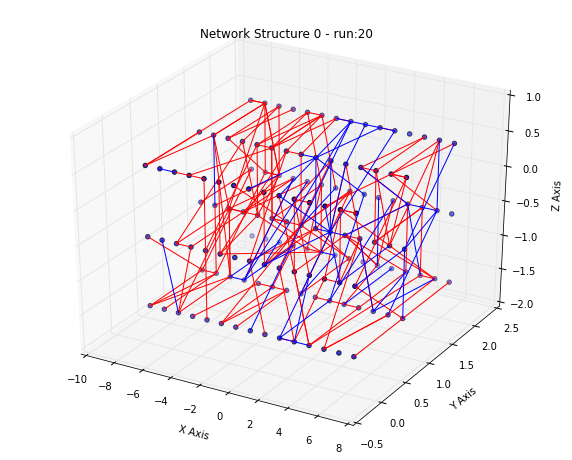

In [281]:
rcParams['figure.figsize'] = (10.0, 8.0)

# Generating the 3D plot: LIQUID->LIQUID...
fig=p3d.show_3d_connections(output_L_L, show_index=False, show_blocked=False, return_figure=True, plot_title='Network Structure '+str(method_type)+' - run:'+str(run_number))
savefig('NetworkStructure_'+str(method_type)+"-"+str(run_number)+'.png')
savefig('NetworkStructure_'+str(method_type)+"-"+str(run_number)+'.pdf')

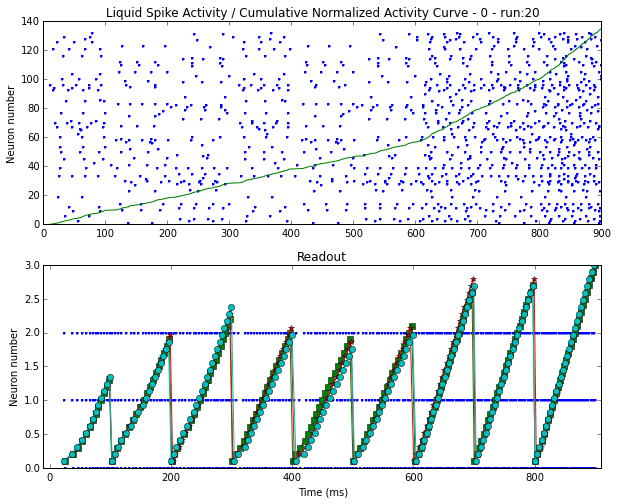

In [282]:
figure()
subplot(211)
raster_plot(LSM, xlabel='')
x, y = ps.plot_cumulative_norm_spike(LSM,Number_of_neurons_lsm); plot(x,y)
title("Liquid Spike Activity / Cumulative Normalized Activity Curve - "+str(method_type)+" - run:"+str(run_number))
subplot(212)
# x, y = ps.plot_cumulative_norm_spike(ROUT,Number_of_neurons_readout); plot(x,y)
raster_plot(ROUT)
x, y = ps.plot_cumulative_norm_spike_individual_rt(ROUT, [0], Number_of_neurons_readout, sim_time*ms); plot(x,y, 's-', label="Neuron 0")
x, y = ps.plot_cumulative_norm_spike_individual_rt(ROUT, [1], Number_of_neurons_readout, sim_time*ms); plot(x,y, '*-', label="Neuron 1")
x, y = ps.plot_cumulative_norm_spike_individual_rt(ROUT, [2], Number_of_neurons_readout, sim_time*ms); plot(x,y, 'o-', label="Neuron 2")
autoscale(enable=True, axis='y', tight=True)
xlim(-sim_time/10,run_repetitions*sim_time+sim_time/10)
title("Readout")
savefig('LiquidActivity_Learning_'+str(method_type)+"-"+str(run_number)+'.png')
savefig('LiquidActivity_Learning_'+str(method_type)+"-"+str(run_number)+'.pdf')
show()

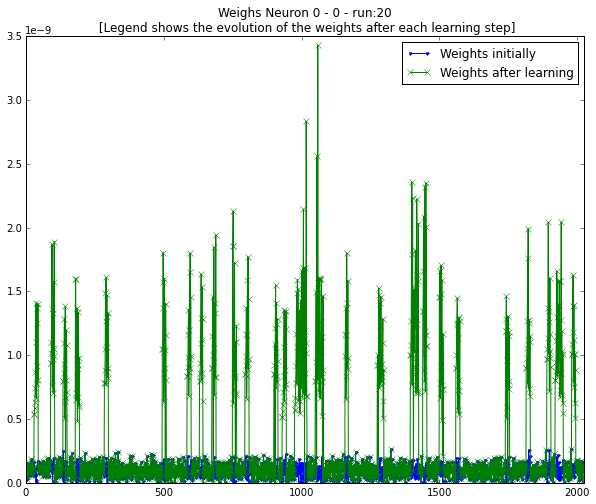

In [283]:
my_markers = ['.-','x-']
figure() # Generate the plot with the weights at each run

i=0
plot(Wlearn[i][0:Number_of_neurons_lsm*Number_of_paths], '.-', label="Weights initially")

i=1
plot(Wlearn[i][0:Number_of_neurons_lsm*Number_of_paths], 'x-', label="Weights after learning")

title("Weighs Neuron 0 - "+str(method_type)+" - run:"+str(run_number)+"\n [Legend shows the evolution of the weights after each learning step]")
autoscale(enable=True, axis='x', tight=True)
legend()
savefig('WeightsNeuron0_'+str(method_type)+"-"+str(run_number)+'.png')
savefig('WeightsNeuron0_'+str(method_type)+"-"+str(run_number)+'.pdf')
show()

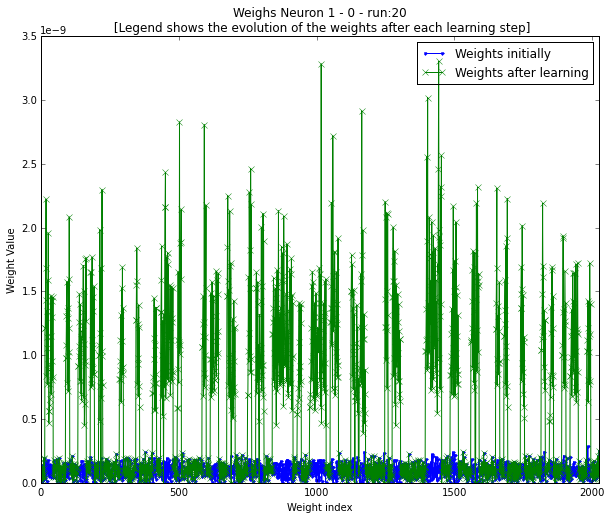

In [284]:

figure() # Generate the plot with the weights at each run

i=0
plot(Wlearn[i][Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths], '.-', label="Weights initially")

i=2
plot(Wlearn[i][Number_of_neurons_lsm*Number_of_paths:2*Number_of_neurons_lsm*Number_of_paths], 'x-', label="Weights after learning")

title("Weighs Neuron 1 - "+str(method_type)+" - run:"+str(run_number)+"\n [Legend shows the evolution of the weights after each learning step]")
autoscale(enable=True, axis='x', tight=True)
ylabel("Weight Value")
xlabel("Weight index")
legend()
savefig('WeightsNeuron1_'+str(method_type)+"-"+str(run_number)+'.png')
savefig('WeightsNeuron1_'+str(method_type)+"-"+str(run_number)+'.pdf')
show()

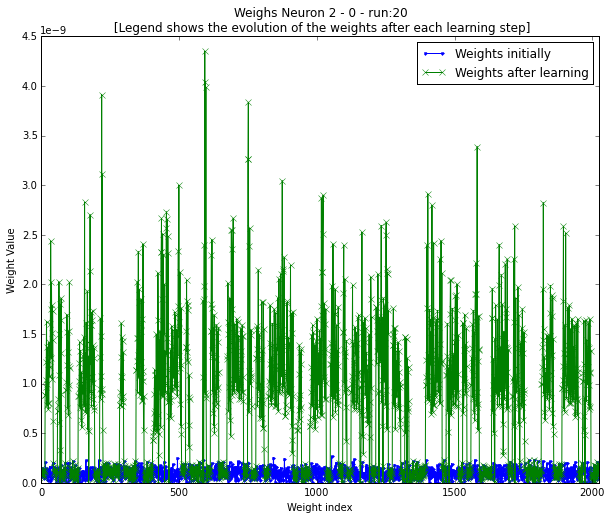

In [285]:
figure() # Generate the plot with the weights at each run

i=0
plot(Wlearn[i][2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths], '.-', label="Weights initially")

i=3
plot(Wlearn[i][2*Number_of_neurons_lsm*Number_of_paths:3*Number_of_neurons_lsm*Number_of_paths], 'x-', label="Weights after learning")

title("Weighs Neuron 2 - "+str(method_type)+" - run:"+str(run_number)+"\n [Legend shows the evolution of the weights after each learning step]")
autoscale(enable=True, axis='x', tight=True)
ylabel("Weight Value")
xlabel("Weight index")
legend()
savefig('WeightsNeuron2_'+str(method_type)+"-"+str(run_number)+'.png')
savefig('WeightsNeuron2_'+str(method_type)+"-"+str(run_number)+'.pdf')
show()


##How to visualize the saved figures...

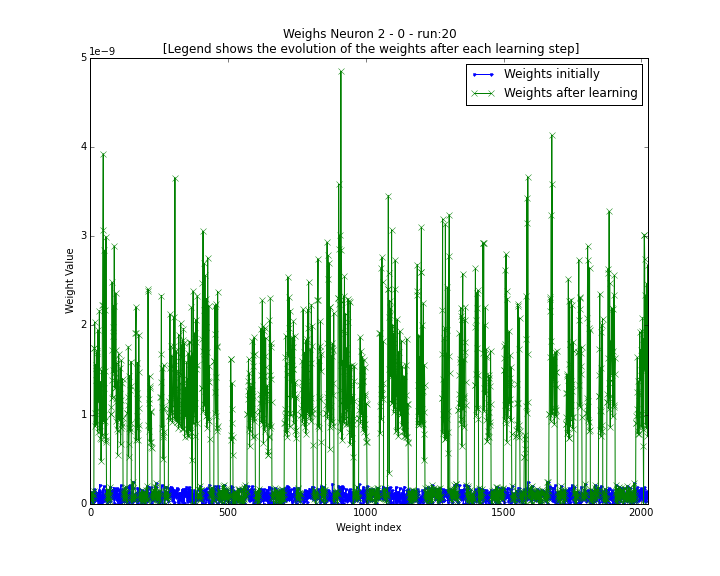

In [157]:
Image('WeightsNeuron2_'+str(method_type)+"-"+str(run_number)+'.png')

In [287]:
import PIL
images = [ PIL.Image.open(f) for f in ['WeightsNeuron2_'+str(method_type)+"-"+str(run_number)+'.png'] ]

def img2array(im):
    if im.mode != 'RGB':
        im = im.convert(mode='RGB')
    return np.fromstring(im.tostring(), dtype='uint8').reshape((im.size[1], im.size[0], 3))

np_images = [ img2array(im) for im in images ]

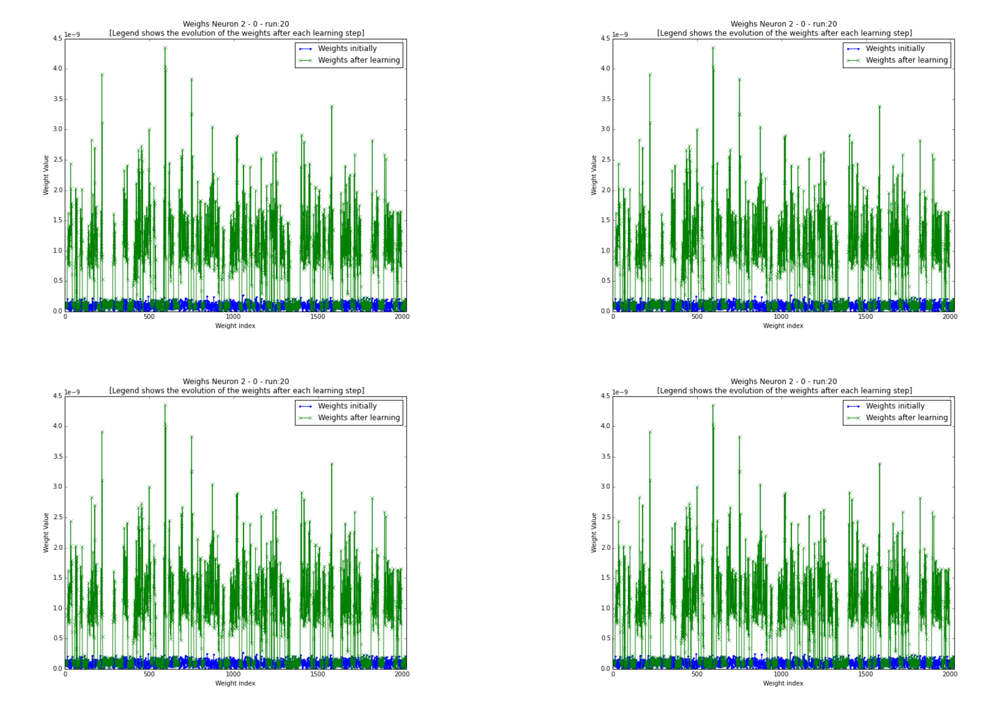

In [314]:
from scipy import misc

my_image = misc.imread('WeightsNeuron2_'+str(method_type)+"-"+str(run_number)+'.png')

fig = figure(figsize=(50,30))
ax1 = fig.add_subplot(2,2,1)
ax2 = fig.add_subplot(2,2,2)
ax3 = fig.add_subplot(2,2,3)
ax4 = fig.add_subplot(2,2,4)

ax1.axis('off')
ax2.axis('off')
ax3.axis('off')
ax4.axis('off')

ax1.imshow(my_image)
ax2.imshow(my_image)
ax3.imshow(my_image)
ax4.imshow(my_image)
tight_layout(pad=0, h_pad=None, w_pad=None, rect=None)
# subplots_adjust(bottom=0,hspace=.01) # Adjust the distance between subplots
show()

In [ ]:
# f=gcf()
# close()
# display(f,Caption_display('Figure Caption'));